<div style="border:solid green 2px; padding: 20px">
<b>Сергей, привет!</b>

Меня зовут Евгений Дащенко, и я буду проверять твой проект. Предлагаю общаться на «ты» 😊 Но если это не удобно - дай знать, и мы перейдем на "вы". 

Моя основная цель — не указать на совершенные тобою ошибки, а поделиться своим опытом и помочь тебе стать аналитиком данных. Ты уже проделал большую работу над проектом, но давай сделаем его еще лучше. Ниже ты найдешь мои комментарии - пожалуйста, не перемещай, не изменяй и не удаляй их. Я буду использовать цветовую разметку:

<div class="alert alert-danger">
<b>Критическая ошибка: ❌</b> Так выделены самые важные замечания. Без их отработки проект не будет принят. </div>

<div class="alert alert-warning">
<b>Хорошо, но можно и лучше: ❗️</b> Так выделены небольшие замечания. Одна-два таких замечания в проекте допустимы, но если их будет больше - тебе будет необходимо внести исправления. Это как тестовое задание при приеме на работу: очень много мелких ошибок могут стать причиной отказа кандидату. 

</div>

<div class="alert alert-success">
<b>Все отлично: ✅</b> Так я выделяю все остальные комментарии.</div>

Давай работать над проектом в диалоге: если ты что-то меняешь в проекте или отвечаешь на мои комменатри — пиши об этом. Мне будет легче отследить изменения, если ты выделишь свои комментарии:
<div class="alert alert-info"> <b>Комментарий студента: ℹ️</b> Например, вот так.</div>

Всё это поможет выполнить повторную проверку твоего проекта оперативнее. 

# Проект по исследованию рынка заведений общественного питания Москвы

В данном проекты мы выступаем в качестве аналитика фонда «Shut Up and Take My Money», который планирует открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.
В первой части проекта необходимо исследовать рынка общественного питания Москвы, отыскать интересные особенности и закономерности, которые помогут определиться с местом для открытия заведения.

Во второй части проекта потребуется провести исследование с целью дать рекомендации инвесторам по открытию кофейни (местоположение, стоимость кофе, размеры и пр.)

Вместе с исследование необходимо выполнить презентацию, в которой будут отражены полученные результаты и рекомендации инвесторам фонда.  

В качестве исходных данных будет выступать датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. 

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Здорово, когда есть вступление в сам проект, каждый сможет быстрее разобраться в концепции / деталях работы. 

</div>

## Оглавление
**1. [Извлечение и знакомство с данными](#start)  
2. [Предобработка данных](#Data_preprocessing)    
3. [Анализ данных](#analysis)  
4. [Детализированное исследование: открытие кофейни](#coffee_time)  
5. [Итог детализированного исследования для октрытия кофейни](#conclusion)**

## Извлечение и знакомство с данными <a id="start"></a> 

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
import datetime as dt
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats as st
import math as mth
import plotly.express as px
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import json
from folium import Map, Choropleth, Marker
from folium.features import CustomIcon


In [3]:
try:
    data = pd.read_csv('C:/Users/zvere/Desktop/Яндекс Практикум/Проект 5 Кофейня/moscow_places.csv', sep=',' )#check
except:
    data = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv', sep=',')

In [4]:
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [6]:
data.duplicated().sum()

0

<div style="border:solid Gold; padding: 40px">
Исходя из первичного анализа датасета можно сделать следующие выводы:  
    
1. Наименование  столбцов - корректное.   
2. Необходимо отметить, что колонка seats (кол-во посадочных мест) имеет тип flota64, что странно - вряд ли можно представить дробным. Колонка hours (часы работы) в object, т.к. имеет информацию не только по часам, но и про гарфик работы: "ежедневно" и т.п.
    
3. Дубликаты отсутствуют.

4. Обращает на себя большое количество пропусков:  
Колонки hours, seats, price, avg_bill, middle_avg_bill, middle_coffee_cup имеют большое количество пропусков, которые мы не можем заполнить, так как у нас недостаточно  данных для заполнения релевантными значениями.  
Соответственно оставляем пропуски.
    
5. Всего в датасете 8406 заведения общественного питания

Для удобства поменяем наименование значений в колонке chain, указывающей на признак заведения (сетевое/несетевое)

In [7]:
data['chain'] = data['chain'].apply(lambda x: 'сетевое заведение' if x == 1 else 'несетевое заведение')

## Предобработка данных <a id="Data_preprocessing"></a> 

**Добавим колонку с указанием названия улицы**  
Ввиду того, что адрес в ДФ указывается поразному, воспользуемся методом where

In [8]:
searchfor = ['посёлок', 'МКАД', 'округ']
data['street'] = np.where(data['address'].str.contains('|'.join(searchfor)), data['address'].str.split(',').str[2], data['address'].str.split(',').str[1])

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Оставил пример ниже, как еще можно вытащить данные из строковых значений.
    
</div>

```python
data['address'].str.split(', ').str[1]
```

<div class="alert alert-info"> Сперва сделал именно таким методом, однако в процессе работы с данными выяснилось, что улица не всегда находится на 2 месте в после города. Попробовал через конструкцию if/else, но не получилось - разобраться не смог. В итоге пошёл путём через where<div>

**Посмотрим, сколько заведений является круглосуточными, добавим соответствующий столбец в датафрейм**

In [9]:
data['hours'].value_counts()

ежедневно, 10:00–22:00                                               759
ежедневно, круглосуточно                                             730
ежедневно, 11:00–23:00                                               396
ежедневно, 10:00–23:00                                               310
ежедневно, 12:00–00:00                                               254
                                                                    ... 
пн-чт 11:00–00:00; пт 11:00–14:00; сб 19:00–00:00; вс 11:00–00:00      1
пн-чт 11:00–00:30; пт 11:00–02:30; сб 12:00–02:30; вс 12:00–00:30      1
пн-пт 13:00–15:30                                                      1
пн-сб 08:00–21:00; вс 09:00–20:00                                      1
пн-чт 13:00–00:00; пт,сб 13:00–02:00; вс 13:00–00:00                   1
Name: hours, Length: 1307, dtype: int64

In [10]:
data['is_24/7'] = data['hours'].map(lambda x: True if 'круглосуточно' in str(x) else False)
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,несетевое заведение,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,несетевое заведение,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,несетевое заведение,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,несетевое заведение,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,сетевое заведение,148.0,Правобережная улица,False


<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Хороший способ разметить данные внутри датасета. Оставил пример ниже как можно это сделать еще.
    
</div>

```python
data['hours'].str.contains('ежедневно, круглосуточно')

```

In [11]:
data['is_24/7'].mean()

0.09183916250297407

Около 9% общепита является круглосуточным

## Анализ данных <a id="analysis"></a> 

**Проанализируем представленные категории общепита в исходных данных**

In [12]:
data_cat = data.groupby('category', as_index = False)['name'].count().sort_values(by='name', ascending=False)
data_cat.rename(columns={"name": "count"}, inplace=True)
data_cat

,category,count
3,кафе,2378
6,ресторан,2043
4,кофейня,1413
0,"бар,паб",765
5,пиццерия,633
2,быстрое питание,603
7,столовая,315
1,булочная,256


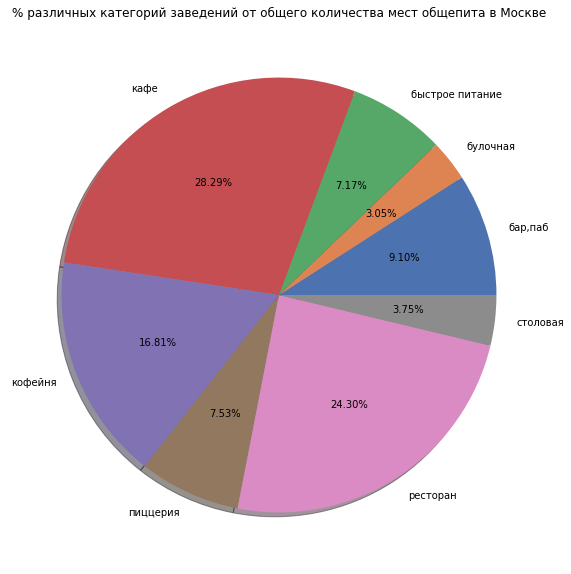

In [13]:
colors = sns.color_palette('deep')[0:8]
data.groupby('category').size().plot(kind='pie', subplots=True, figsize=(10, 10), autopct='%1.2f%%', shadow=True, colors = colors)
plt.title("% различных категорий заведений от общего количества мест общепита в Москве")
plt.ylabel("")
sns.set(font_scale = 1.25)
plt.show()

Больше всего кафе, рестаранов и кофеен, меньше всего столовых и булочных

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Отличный и наглядный график 👍
    
Здорово, когда он подписан. Так быстрее понять о чем идёт речь на нём.
    
</div>

**Изучим количество посадочных мест в разных типах заведений**

In [14]:
data_seat_cat = data.groupby('category', as_index = False)['seats'].mean().round(0).sort_values(by='seats', ascending=False)
fig = px.bar(data_seat_cat.sort_values(by='seats', ascending=False), 
             x='category', 
             y='seats', 
             text='seats')

fig.update_layout(title='Медианное количество посадочных мест в заведениях разной категории', title_x=0.45, 
                   xaxis_title='Категория заяведения',
                   yaxis_title='Количество посадочных мест')
fig.show() 

Больше всего посадочных мест в ресторанах и барах. Меньше всего места в булочных.
При этом медианные значения выглядит завышенными, попробуем проверить распределения по разных заведениям

<Figure size 720x720 with 0 Axes>

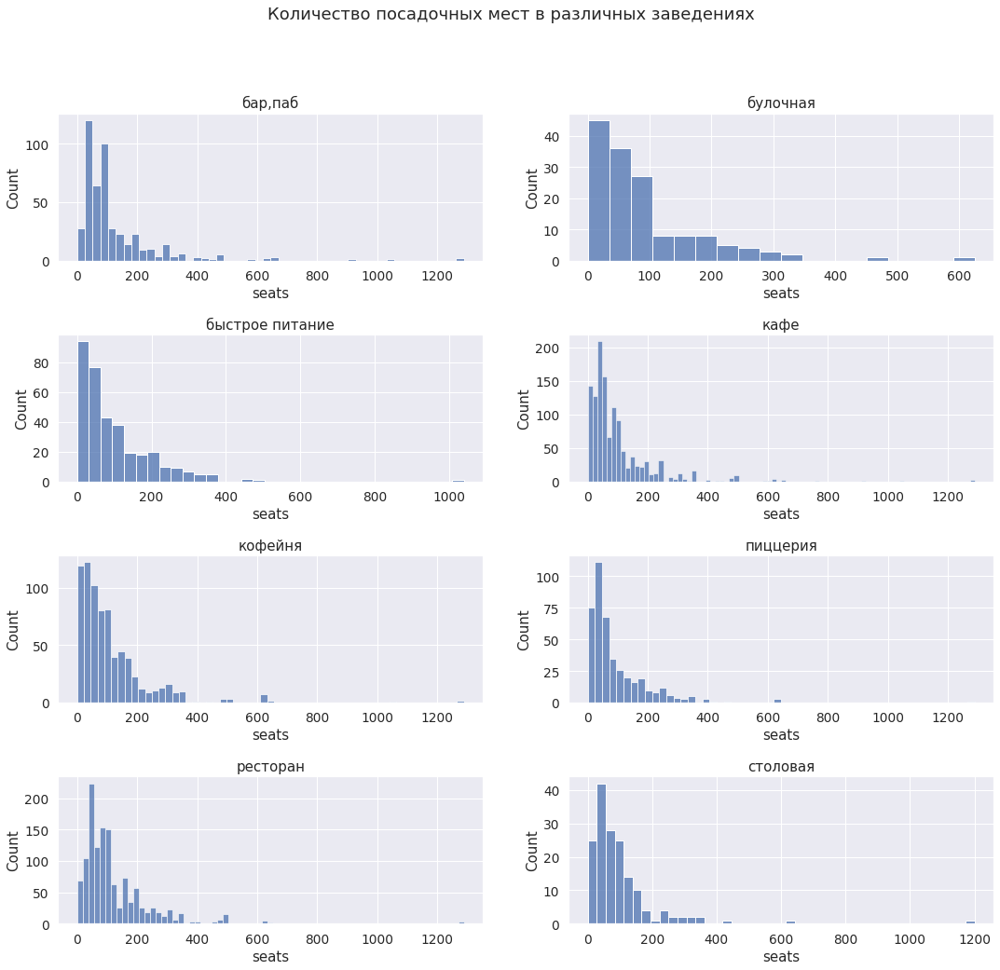

In [15]:
fig = plt.figure(figsize=(10, 10))
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(18, 16))
fig.subplots_adjust(hspace=0.5)
fig.suptitle('Количество посадочных мест в различных заведениях')

# Generate histograms
for ax, (name, subdf) in zip(axes.flatten(), data.groupby('category')):
    sns.histplot(subdf, x='seats', ax=ax)
    ax.set_title(name)

plt.show()

Из представленных графиков видно, что имеются большие "хвосты" у всех типов заведений. Скорей всего это некорректные данные. Исключим из ДФ все заведения с 250 и выше посадочными местами

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Здорово, что используешь метод `subplots`, сам достаточно часто его применяю в своей практике 😊
</div>

In [16]:
data['seats'] = data['seats'].fillna('0').astype('int')
data_new = data[data['seats'] < 250]
data_new.shape[0]

7935

In [17]:
data_new.shape[0] / data.shape[0] 

0.9439685938615274

Таких заведений оказалось не очень много. Менее 6 процентов.  
Снова построим график посадочных мест по разным типам заведений

In [18]:
data_seat_cat = data.groupby('category', as_index = False)['seats'].mean().round(2).sort_values(by='seats', ascending=False)
fig = px.bar(data_seat_cat.sort_values(by='seats', ascending=False), 
             x='category', 
             y='seats', 
             text='seats')

fig.update_layout(title='Среднее количество посадочных мест в заведениях разной категории', title_x=0.45, 
                   xaxis_title='Категория заяведения',
                   yaxis_title='Количество посадочных мест')
fig.show() 

Теперь данные выглядят более реалистичными, но по прежнему в барах и ресторанах больше всего посадочных мест, а в кафе и булочных - меньше всего

<div class="alert alert-warning">
<b>Комментарий ревьюера: ❗️</b>

На этом графике лучше подписать сами значения, т.к. текст дублируется из оси X.
    
</div>

<div class="alert alert-info"> Согласен, упустил этот момент <div>

**Проанализируем соотношение сетевых и несетевых заведений**

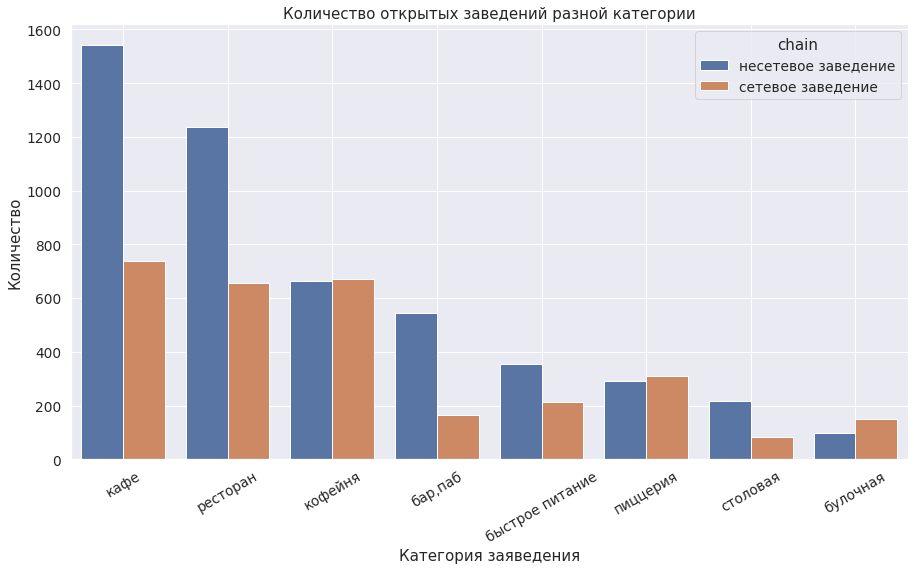

In [19]:
data_chain = data_new.groupby(['category', 'chain'], \
                          as_index = False)['name'].count().sort_values(by='name', ascending=False)
sns.set_style('dark')
plt.figure(figsize=(15, 8))
sns.barplot(x='category', y='name', data=data_chain, hue='chain', palette = colors)
plt.title('Количество открытых заведений разной категории')
plt.xlabel('Категория заяведения')
plt.ylabel('Количество')
plt.grid()
plt.xticks(rotation=30)
sns.set(font_scale = 1.5)
plt.show()

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

На первый взгляд так и не скажешь, что несетевых объектов больше. 
    
Хорошо, что подтвердили это с помощью наших данных.
    
</div>

In [20]:
data_new['chain'].value_counts()

несетевое заведение    4950
сетевое заведение      2985
Name: chain, dtype: int64

Несетевых заведений значительно больше. Если смотреть по категориям, то только сетевых кофеен, булочных и пиццерий несколько больше, чем несетевых. В самых популярных категориях (кафе и рестораны) разрыв меду количеством несетевых и сетевых достаточно существенный. 

**Изучим самые популярные сетевые заведения**

In [21]:
data_popular = data_new.groupby(['name', 'category'])['chain'].count().sort_values(ascending=False).reset_index()
data_popular.rename(columns={"chain": "count"}, inplace=True)
data_popular = data_popular.iloc[0:15]
data_popular.at[9,'name']= 'КЛ бр. Караваевых'
data_popular

,name,category,count
0,Кафе,кафе,158
1,Шоколадница,кофейня,111
2,Домино'с Пицца,пиццерия,75
3,Додо Пицца,пиццерия,70
4,Яндекс Лавка,ресторан,65
5,One Price Coffee,кофейня,64
6,Cofix,кофейня,62
7,Prime,ресторан,46
8,КОФЕПОРТ,кофейня,40
9,КЛ бр. Караваевых,кафе,37


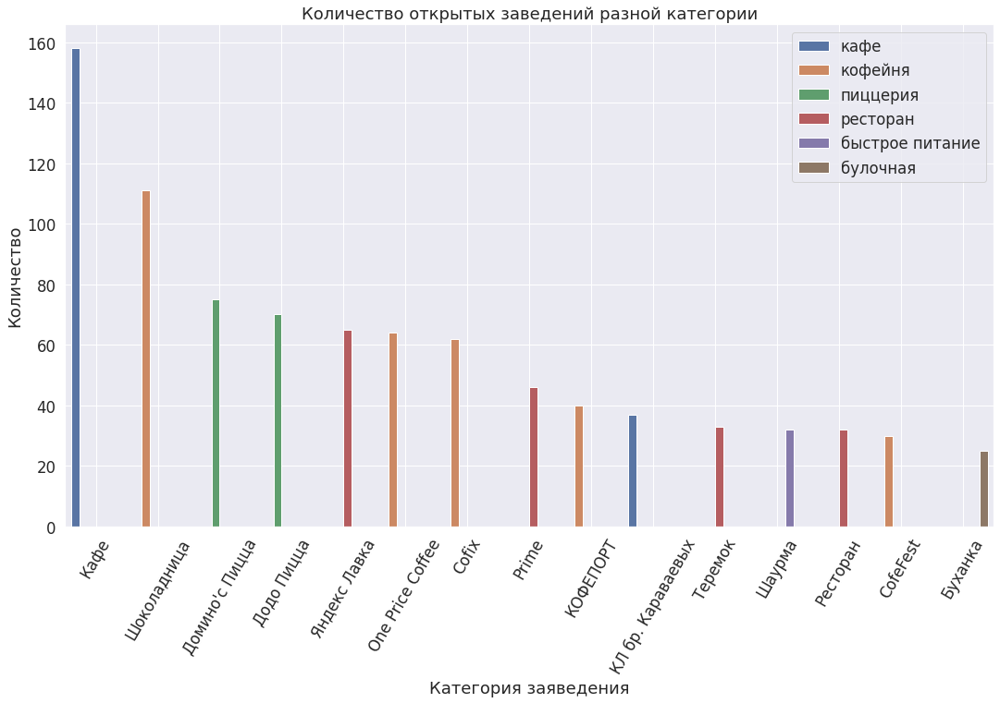

In [22]:
plt.figure(figsize=(18, 10))
sns.barplot(x='name', y='count', data=data_popular, hue='category', palette = colors)
plt.title('Количество открытых заведений разной категории')
plt.xlabel('Категория заяведения')
plt.ylabel('Количество')
plt.grid(True)
plt.legend(loc='upper right')
plt.xticks(rotation=60)
sns.set(font_scale = 1.5)
plt.show()

Кафе "кафе" и ресторан "ресторан" - как несомненная классика, так и вероятная ошибка в данных.  
Яндекс Лавка с Шаурмой тоже затесались в этот список, очевидно, по ошибке (при всём уважении к шаурме).   
Тем не менее бОльшую часть из представленных заведений на слух знает почти каждый.
Из 15 самых популярных заведений (за исключением кафе-кафе) всего 2 кафе. Ресторанов тоже два, один из которых Теремок - эти данные подтверждают предыдущий график на котором отчётливо видно, что сетевых кафе и ресторанов  не так много.
При этом обращает на себя большая популярность пиццерий и кофеен.

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>


Здорово, что получилось визуализировать в том числе категории на этом графике 👍
</div>

**Посмотрим как общепит распределен по районам**

In [23]:
data_new['district'].value_counts()

Центральный административный округ         2084
Северный административный округ             855
Северо-Восточный административный округ     842
Южный административный округ                805
Восточный административный округ            781
Западный административный округ             762
Юго-Восточный административный округ        702
Юго-Западный административный округ         700
Северо-Западный административный округ      404
Name: district, dtype: int64

In [24]:
data_district = data_new.groupby('district', as_index = False)['name'].count()
data_district.loc[10] = data_district['name'].sum()
data_district.rename(columns={"name": "count"}, inplace=True)
data_district.at[10,'district'] = 'Все округа'
data_district['diff'] = data_new.shape[0]-data_district['count']
data_district.sort_values(by='count', ascending=False)

,district,count,diff
10,Все округа,7935,0
5,Центральный административный округ,2084,5851
2,Северный административный округ,855,7080
3,Северо-Восточный административный округ,842,7093
8,Южный административный округ,805,7130
0,Восточный административный округ,781,7154
1,Западный административный округ,762,7173
6,Юго-Восточный административный округ,702,7233
7,Юго-Западный административный округ,700,7235
4,Северо-Западный административный округ,404,7531


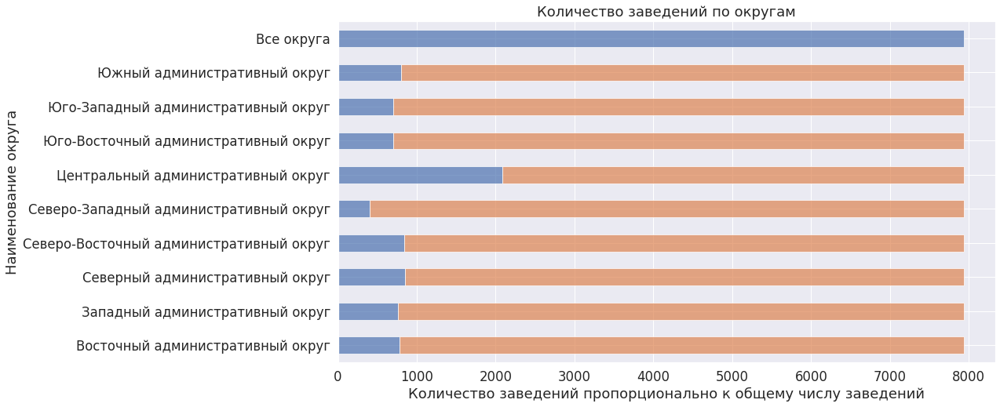

In [25]:
data_district.plot(
    x = 'district',
    kind = 'barh',
    stacked = True,
    title = 'Количество заведений по округам',
    mark_right = True,
    alpha=0.7,
    figsize=(15, 8),
    legend=False)
plt.xlabel('Количество заведений пропорционально к общему числу заведений')
plt.ylabel('Наименование округа')
plt.show()

Достаточно логично, что больше всего заведений в ЦАО с большим отравом. Любопытно, что сильно отстаёт от других СЗАО

**Проанализируем рейтинги заведений**

In [26]:
data_rating = data_new.groupby('category')['rating'].mean().round(2).reset_index()
data_rating

,category,rating
0,"бар,паб",4.39
1,булочная,4.26
2,быстрое питание,4.05
3,кафе,4.12
4,кофейня,4.28
5,пиццерия,4.30
6,ресторан,4.29
7,столовая,4.21


In [27]:
fig = px.line(data_rating, x='category', y='rating', title='Медианный рейтинг заведений', text="rating", markers=True)
fig.update_xaxes(tickangle=45) 
fig.update_traces(textposition="bottom center")
fig.update_layout(title='Медианный рейтинг заведений', title_x=0.45, 
                   xaxis_title='Категория заяведения',
                   yaxis_title='Рейтинг')
fig.show() 

Лучшие рейтинги в барах (интересно, дело в обилии алкоголя?). А вот фастфуд и кафе немного проседают в части рейтингов.

**Посмотрим как средний рейтинг распределен по округам**

In [28]:
# try:
#     with open('C:/Users/zvere/Desktop/Яндекс Практикум/Проект 5 Кофейня/admin_level_geomap.geojson', 'r') as f:
#         geo_json = json.load(f)
# except:
#     with open('https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson', 'r') as f:
#         geo_json = json.load(f)    
# по какой то причине, если ссылаться на локальный файл - вся карта Москвы черного оттенка (не понимаю, что не так)

<div class="alert alert-warning">
<b>Комментарий ревьюера: ❗️</b>

Если в проекте есть закомментированный код и он не используется в проекте, то лучше всего избавляться от него, чтобы он также не портил презентабельность проекта.
    
</div>

<div class="alert alert-info"> Принято. Оставил намерено эту часть, так как наставник не смог ответить, почему локальный файл некорректно отображается на карте. Подумал, что может ревьюер знает причину. 
    Весь остальной закомментированный код из проекта был удален <div>


<div class="alert alert-success">
<b>Комментарий ревьюера (2): ✅</b>

Возможно локальный файл "битый" можно попробовать удалить и закинуть новый файл. 
    
    
</div>

In [29]:
data_map_rating = data_new.groupby('district', as_index=False)['rating'].agg('median')
data_map_rating

,district,rating
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.3
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [30]:
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

moscow_lat, moscow_lng = 55.751244, 37.618423
m_rating = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=data_map_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m_rating)

marker_cluster = MarkerCluster().add_to(m_rating)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

data_new.apply(create_clusters, axis=1)

m_rating

В центре, видимо, лучше обслуживание. Или туристы непритязательны. Но вот в ЮВАО  медианный рейтинг отчётливо ниже, стоит задуматься!

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Супер 👍, кластеры то что нужно, т.к. не сильно нагружают график из-за своей сгруппированности. Если убрать кластеры, то тетрадка будет работать тяжело из-за отображения буквально каждой точки на карте.
    
---
    
Здорово, что на одном графике удалось визуализировать сразу и рейтинг.
    
</div>

<div class="alert alert-info"> Можно ли шкалу, находящуюся в правом верхнем углу, либо увеличить, либо вывести за пределы карты? Сейчас она плохо читается. <div> 

**Найдём топ 15 самых популярных улиц по количеству заведений и категориям**

In [31]:
data_popular_street = data_new.groupby(['street', 'category'], as_index=False)['name'].agg('count').sort_values(by='name', ascending=False)
data_popular_street1 = data_popular_street.iloc[0:1]
n = 1
while len(data_popular_street1['street'].unique()) < 15:
    data_popular_street1 = data_popular_street.iloc[0:n]
    n = n + 1  
data_popular_street1.rename(columns={"name": "count"}, inplace=True)
data_popular_street1.head()
warnings.filterwarnings("ignore")

/opt/conda/lib/python3.9/site-packages/pandas/core/frame.py:4441: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [32]:
len(data_popular_street1['street'].unique())

15

<div class="alert alert-info"> Придумал только через цикл while как выделить 15 самых популярных улиц с учётом категорий. Но здесь pandas ругается, пробовал .copy() вставить, но не помогло. Если есть способ лаконичней - прошу подсказать <div> 

<div class="alert alert-success">
<b>Комментарий ревьюера (2): ✅</b>

Да, согласен путь непростой 😅
    
В общем можно посчитать топ 15 улиц, записать их в отдельный список или отобразить только уникальные значения. Затем отфильтровать датасет только по этим улицам и сделать расчет с группировкой. Тогда будет все проще.
    
    
</div>

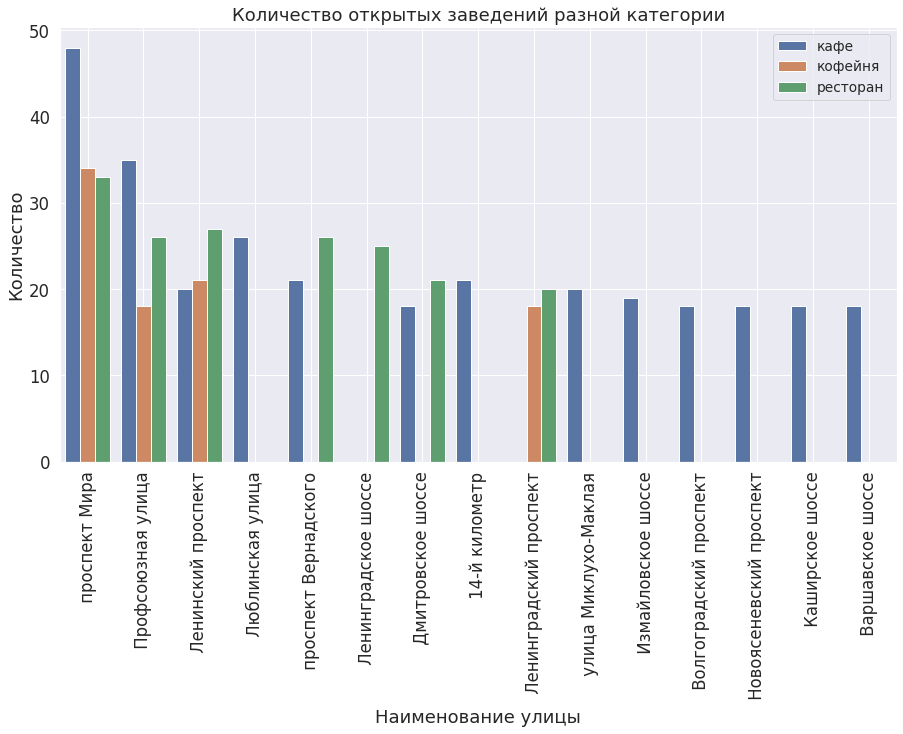

In [33]:
plt.figure(figsize=(15, 8))
sns.barplot(x='street', y='count', data=data_popular_street1, hue='category', palette = colors)
plt.title('Количество открытых заведений разной категории')
plt.xlabel('Наименование улицы')
plt.ylabel('Количество')
plt.grid(True)
plt.xticks(rotation=90)
sns.set(font_scale = 1.25)
plt.legend(loc='upper right')
plt.show()

<div style="border:solid Gold; padding: 40px">
Кафе повсюду! Проспект Мира самая популярная улица в части количества заведений, как не крути. 
Любропытно, что популярными улицами являются шоссе - видимо, за счёт протяжености 

<div class="alert alert-danger">
<b>Комментарий ревьюера: ❌</b>

<s>У нас здесь отображено не 15 улиц. Давай поправим этот момент.
    
</div>

**Изучим данные об улицах, на которых находится всего одно заведение**

In [34]:
data_no_popular_street = data_new.groupby(['street'], as_index=False)['name'].agg('count').sort_values(by='name', ascending=True)
data_no_popular_street.rename(columns={"name": "count"}, inplace=True)
data_no_popular_street = data_no_popular_street[data_no_popular_street['count'] == 1]
display(data_no_popular_street.head())

,street,count
0,1-й Автозаводский проезд,1
720,Орловский переулок,1
722,Оршанская улица,1
728,Островная улица,1
731,Отрадный проезд,1


In [35]:
data_no_popular_street.shape[0]

494

Всего 494 улиц, на которых расположено всего по одному месте общепита. По всей видимости, это мелкий улицы, проезды и переулки. Посмотрим на категории заведений

In [36]:
data_no_popular_street = pd.merge(data_no_popular_street, data_new[['street', 'category']], how='left', on = 'street')
data_no_popular_street.head()

,street,count,category
0,1-й Автозаводский проезд,1,кафе
1,Орловский переулок,1,кофейня
2,Оршанская улица,1,"бар,паб"
3,Островная улица,1,столовая
4,Отрадный проезд,1,ресторан


In [37]:
data_no_popular_street['category'].value_counts()

кафе               175
ресторан            96
кофейня             95
бар,паб             42
столовая            37
быстрое питание     24
пиццерия            16
булочная             9
Name: category, dtype: int64

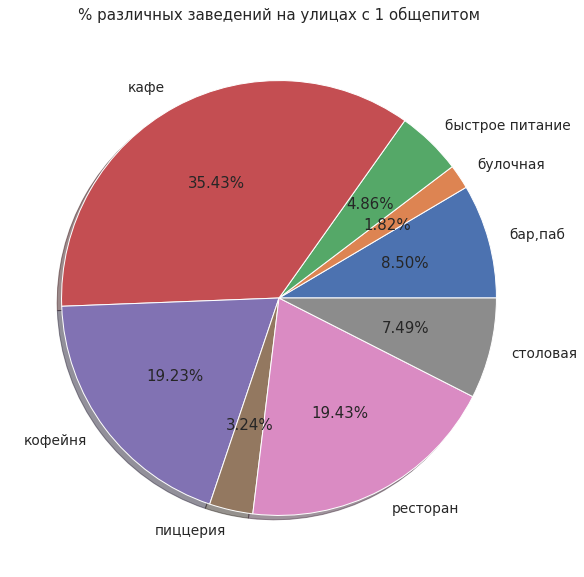

In [38]:
colors = sns.color_palette('deep')[0:8]
data_no_popular_street.groupby('category').size().plot(kind='pie', subplots=True, figsize=(10, 10), autopct='%1.2f%%', shadow=True, colors = colors)
plt.title("% различных заведений на улицах с 1 общепитом")
plt.ylabel("")
sns.set(font_scale = 1.25)
plt.show()

Если сравнивать пропорции наличия заведений на пустынных улицах (где всего 1 заведение общепита) с общей выборкой, то можно увидеть, что на улицах с 1 заведений больше кафе и столовых, но меньше остальных типов заведений, особенно рестаранов, пиццерий

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Обрати внимание, что некоторые графики у нас повторяются.
    
Это говорит о том, что мы можем создать функцию для постоянного их построения. И с помощью этого повысить оптимизацию своего кода и презентабельность проекта в целом.
    
То есть мы можем создать "обёртки" с методами, и в функцию будем подавать нужные перменные: 
    
- датасет
- подписи графика и осей
- и прочие любые настройки
    
----
    
Здорово, что визуализируешь эту информацию, обычно проходят мимо неё 😅
    
</div>

<div class="alert alert-info"> Согласен, с функцией было бы удобней. Но когда начинал делать проект не понимал, сколько и каких графиков будет, поэтому сразу не сообразил, что имеет смысл написать функцию для графиков <div> 

<div class="alert alert-success">
<b>Комментарий ревьюера (2): ✅</b>

Будем иметь в виду этот момент на будущее.  
    
</div>

**Изучим среднюю стомость чека по округам**

In [39]:
data_median_district = data_new.groupby('district', as_index=False)['middle_avg_bill'].agg('median')
data_median_district

,district,middle_avg_bill
0,Восточный административный округ,550.0
1,Западный административный округ,975.0
2,Северный административный округ,650.0
3,Северо-Восточный административный округ,500.0
4,Северо-Западный административный округ,675.0
5,Центральный административный округ,1000.0
6,Юго-Восточный административный округ,436.5
7,Юго-Западный административный округ,600.0
8,Южный административный округ,500.0


In [40]:
m_price = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=data_median_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный чек в заведениях в разных районах',
).add_to(m_price)

marker_cluster = MarkerCluster().add_to(m_price)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)

data_new.apply(create_clusters, axis=1)

m_price

Больше всего в среднем придётся заплатить в центре Москвы, а также на западе столицы. По всей видимости, на западе от Москвы находятся элитные жилые поселки. 
Очевидно, что за пределами центра и элитного района средний чек ниже. При этом он разнится от района к району, например на северо-западе Москвы он выше, чем на юго-востоке

**Посмотрим, сколько заведений с низким рейтингом**

In [41]:
low_rating = data_new[data_new['rating'] < 3]
low_rating.shape[0]

205

Всего 205 заедений с рейтингом меньше 3

In [42]:
low_rating['district'].value_counts()

Юго-Восточный административный округ       49
Северо-Восточный административный округ    33
Западный административный округ            30
Юго-Западный административный округ        23
Восточный административный округ           21
Северный административный округ            17
Южный административный округ               16
Северо-Западный административный округ     11
Центральный административный округ          5
Name: district, dtype: int64

In [43]:
m_low_rating = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m_low_rating)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
Choropleth(
    geo_data=state_geo,
    data=low_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m_low_rating)
    
low_rating.apply(create_clusters, axis=1)

m_low_rating

Удивительно, но в центре Москвы почти нет заведений с низким рейтингом. При этом на юго-западе с рейтингами заведений всё не очень хорошо

**Проанализируем медианную стоимость чека в разных заведениях от округа к округу**

In [44]:
data_price = data_new.pivot_table(index='district', values='middle_avg_bill', columns='category', aggfunc=('median'))
data_price

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Восточный административный округ,1105.0,300.0,337.5,450.0,400.0,500.0,1000.0,300.0
Западный административный округ,1250.0,600.0,350.0,600.0,600.0,700.0,1250.0,300.0
Северный административный округ,1250.0,450.0,300.0,500.0,325.0,650.0,1100.0,300.0
Северо-Восточный административный округ,850.0,500.0,425.0,462.5,337.5,500.0,900.0,275.0
Северо-Западный административный округ,1000.0,200.0,275.0,650.0,325.0,549.5,1250.0,300.0
Центральный административный округ,1250.0,925.0,450.0,700.0,500.0,1000.0,1250.0,300.0
Юго-Восточный административный округ,925.0,375.0,300.0,387.5,250.0,500.0,850.0,275.0
Юго-Западный административный округ,1000.0,500.0,375.0,450.0,375.0,500.0,1050.0,305.0
Южный административный округ,1100.0,437.5,400.0,600.0,350.0,500.0,950.0,277.5


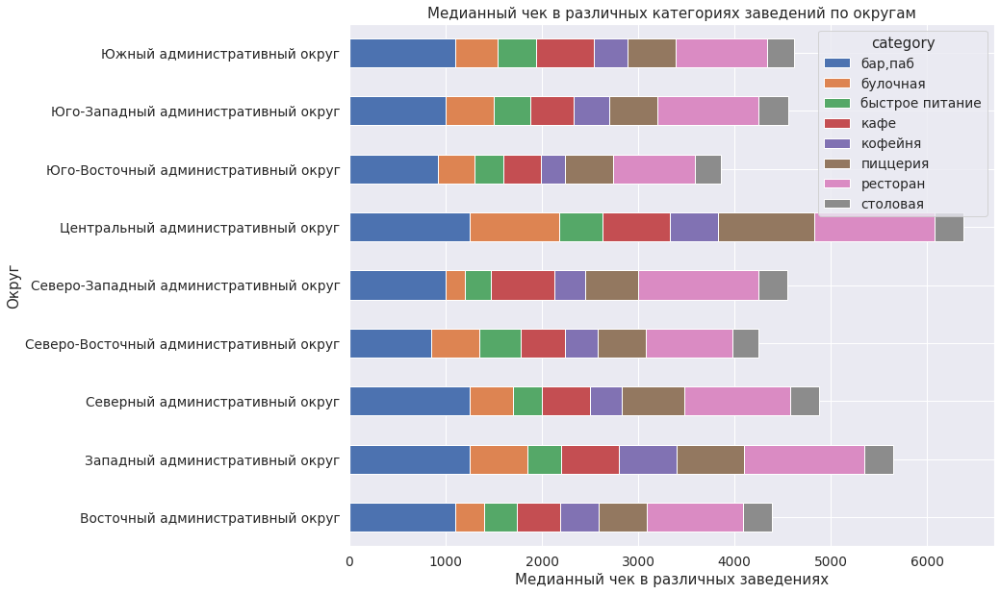

In [45]:
ax = data_price.plot(kind='barh', stacked=True, figsize=(12,10))
ax.set(xlabel='Медианный чек в различных заведениях', ylabel='Округ', title='Медианный чек в различных категориях заведений по округам') 
plt.show()

Из графика видно, стоимость среднего чека в разных заведениях отличается по округам, иногда довольно неожиданно. Так, чек в кофейнях в ЦАО ниже, чем в ЗАО. Любопытно, что в ЦАО средний чек в пиццериях и булочных значительно выше, чем в остальных районах.
В целом, по совокупности - средний чек выше в ЦАО.

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

Чтобы подписать значения в других библиотеках, можно использовать примеры ниже: 
    

- в библиотеке `matplotlib` <a href="https://queirozf.com/entries/add-labels-and-text-to-matplotlib-plots-annotation-examples">первый пример</a>, <a href="https://matplotlib.org/stable/gallery/lines_bars_and_markers/barchart.html">второй пример</a> для группированных графиков
    
- в библиотеке `seaborn` [тут](https://stackoverflow.com/questions/43214978/how-to-display-custom-values-on-a-bar-plot) и [тут](https://www.statology.org/seaborn-barplot-show-values/)
    
</div>

<div class="alert alert-info"> Спасибо, любопытно. Но подписать значения для matplotlib построенного из сводной таблицы не получилось, к сожалению. <div> 

<div class="alert alert-success">
<b>Комментарий ревьюера (2): ✅</b>

Для таких графиков можно посмотреть еще тут
    
https://stackoverflow.com/questions/41296313/stacked-bar-chart-with-centered-labels
    
</div>

**Взглянем на количество разных типов заведений по округам**

In [46]:
data_count = data_new.pivot_table(index='district', values='name', columns='category', aggfunc=('count'))
data_count

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Восточный административный округ,45,25,69,268,103,71,160,40
Западный административный округ,43,32,56,221,136,65,187,22
Северный административный округ,64,37,55,228,184,69,178,40
Северо-Восточный административный округ,57,26,78,256,153,66,168,38
Северо-Западный административный округ,22,12,30,114,62,40,107,17
Центральный административный округ,341,49,77,430,403,104,617,63
Юго-Восточный административный округ,38,13,67,278,88,55,138,25
Юго-Западный административный округ,38,27,61,233,94,64,166,17
Южный административный округ,62,24,76,251,111,67,174,40


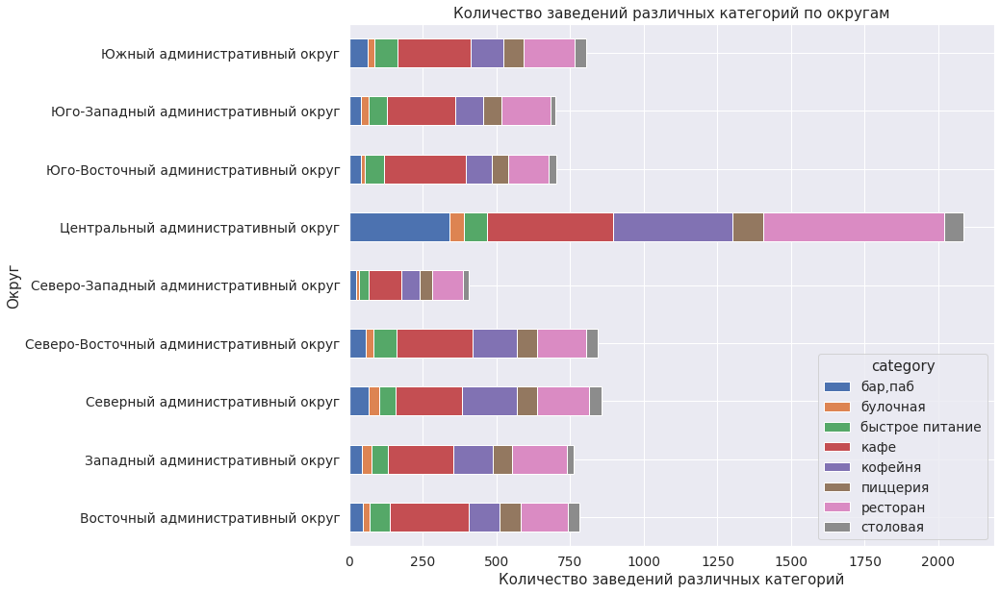

In [47]:
data_count.plot(kind='barh', stacked=True, figsize=(12,10))
plt.xlabel('Количество заведений различных категорий')
plt.ylabel('Округ')
plt.title('Количество заведений различных категорий по округам')
plt.show()

Здесь ожидаемо наблюдаем большой перевес ЦАО. Остальные округа более-менее равномерно насыщены заведениями, за исключением СЗАО

<div style="border:solid Gold; padding: 40px">
Изучив исходные данные по общепитам Москвы можно сделать следующие выводы:
    
1. Больше всего в Москве кафе и ресторанов, а меньше всего булочных и столовых.
2. Посадочных мест больше всего в ресторанах и барах.
3. Сетевых заведений значительно меньше, чем несетевых. При этом самым популярным сетевым заведением в Москве является Шоколадница.
4. Больше всего всех типов заведений в ЦАО. Меньше всего в СЗАО.
5. Проспект Мира - самая густонаселенная заведениями общепита улица в Москве
6. Самый большой средний чек по всем категориями заведений в ЦАО, недалеко от него ЗАО. При этом в разных округах сильно различается средний чек в разных категориях.
7. Помимо прочего в ЦАО и самый высокий средний рейтинг заведений. Количеством заведений с большим антирейтингом славится ЮВАО.
    
    В целом, все полученные в ходе анализа данных результаты вполне логичны и ожидаемы

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>
    
Хочется отметить, что на протяжении всего проекта чувствуется глубизна проработки задачи, что в свою очередь говорит о серьезном подходе к выполнению всего проекта в целом. А это не может не радовать в нашем деле, так держать! 😊👍
    
</div>

### Детализированное исследование: открытие кофейни <a id="start"></a> 

Для того, чтобы найти удачное место для кофейни требуется изучить разные аспекты, касающиеся кофеен и другого общепита

**Посмотрим сколько всего кофеен в Москве, а также сколько из них работают круглосуточно**

In [48]:
data_coffee = data_new[data_new['category'] == 'кофейня']
data_coffee.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,несетевое заведение,0,улица Маршала Федоренко,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,сетевое заведение,0,парк Левобережный,False
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,сетевое заведение,46,Коровинское шоссе,False
46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,сетевое заведение,0,улица Маршала Федоренко,False
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,сетевое заведение,0,улица Дыбенко,False


In [49]:
data_coffee['name'].count()

1334

Всего 1334 кофеен


In [50]:
data_coffee[data_coffee['is_24/7'] == 1]['name'].count()

74

Из них 74 работают круглосуточно

**Взглянем на распределение рейтинга кофеен**

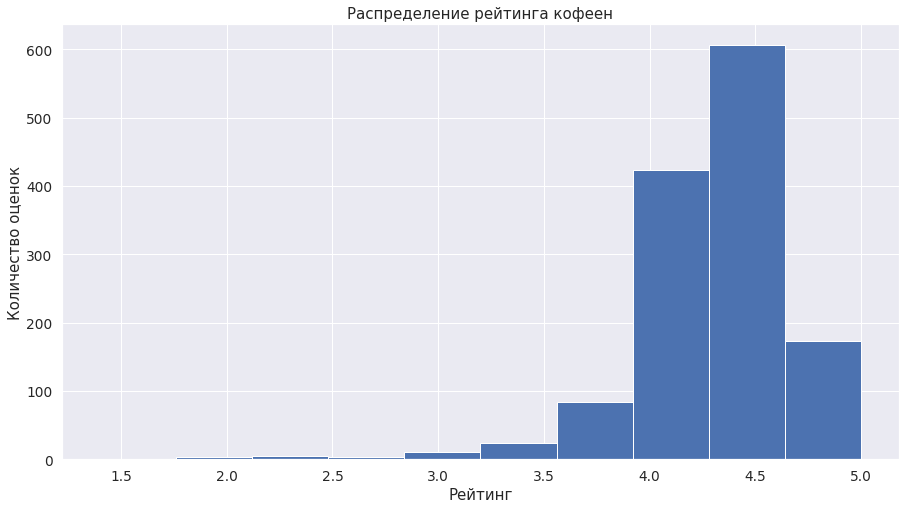

In [51]:
data_coffee['rating'].hist(figsize=(15, 8))
plt.xlabel('Рейтинг')
plt.ylabel('Количество оценок')
plt.title('Распределение рейтинга кофеен')
plt.show()

Большинство кофеен имеют рейтинг больше 4. 

**Обратим внимание на средний рейтинг кофеен по округам**

In [52]:
data_coffee_rating = data_coffee.groupby('district',as_index=False)['rating'].mean().round(2)
data_coffee_rating

,district,rating
0,Восточный административный округ,4.28
1,Западный административный округ,4.19
2,Северный административный округ,4.30
3,Северо-Восточный административный округ,4.22
4,Северо-Западный административный округ,4.33
5,Центральный административный округ,4.33
6,Юго-Восточный административный округ,4.23
7,Юго-Западный административный округ,4.28
8,Южный административный округ,4.22


In [53]:
fig = px.line(data_coffee_rating, x='district', y='rating', text="rating",  markers=True)
fig.update_xaxes(tickangle=60) 
fig.update_traces(textposition="middle left")
fig.update_layout(title='Средний рейтинг кофеен по округам', title_x=0.45, 
                   xaxis_title='Округ',
                   yaxis_title='Рейтинг')
fig.show() 

Самый высокий рейтинг кофеен в ЦАО и СЗАО. Хуже всего с рейтингом в ЗАО

<div class="alert alert-warning">
<b>Комментарий ревьюера: ❗️</b>

В целом рекомендую следовать одному стилю в своем проекте, например: 
    
- размер графиков должен быть одинаковый для каждого из них
- цветовая палитра должна быть одинаковой
- если где-то добавляем значени, то нужно это делать везде
    
Так заказчику будет проще ориентироваться в самом проекте и делать выводы

</div>

<div class="alert alert-info"> Принято, звучит логично. Но в нашем проекте намерено пробовал работать с разными библиотеками, насколько понял привести их к одному стилю не представляется возможным. Кое где изменил палитру, чтобы в целом приблизить к одному стилю графики и добавил значения.
    Что касается размера графиков - то их выбирал исходя из читаемости графика, но в целом идея ясна<div> 

<div class="alert alert-success">
<b>Комментарий ревьюера (2): ✅</b>

Да, это нормально попробовать все 😊, просто будем иметь в виду на будущее.    
    
    
</div>

**Изучим медианную стоимость чашки кофе в кофейнях по округам**

In [54]:
data_coffee_price = data_coffee.groupby('district',as_index=False)['middle_coffee_cup'].median().round(2)
data_coffee_price

,district,middle_coffee_cup
0,Восточный административный округ,135.0
1,Западный административный округ,185.0
2,Северный административный округ,160.0
3,Северо-Восточный административный округ,166.0
4,Северо-Западный административный округ,165.0
5,Центральный административный округ,190.0
6,Юго-Восточный административный округ,150.0
7,Юго-Западный административный округ,198.0
8,Южный административный округ,142.0


In [55]:
fig = px.bar(data_coffee_price.sort_values(by='middle_coffee_cup', ascending=False), 
             x='district', 
             y='middle_coffee_cup', 
             text='middle_coffee_cup') 
fig.update_xaxes(tickangle=60) 

fig.update_layout(title='Медианная стоимость чашки кофе в кофейнях по округам', title_x=0.45,
                   xaxis_title='Стоимость',
                   yaxis_title='Округ')
fig.show() 

Дороже всего кофе стоит в ЮЗАО, ЦАО и ЗАО. Дешевле всего в ВАО и ЮАО

**Исследуем зависимость стоимости кофе от рейтинга кофейни в разных районах города**

In [56]:
data_rating_price = pd.merge(data_coffee_price, data_coffee_rating, on = 'district')
data_rating_price

,district,middle_coffee_cup,rating
0,Восточный административный округ,135.0,4.28
1,Западный административный округ,185.0,4.19
2,Северный административный округ,160.0,4.30
3,Северо-Восточный административный округ,166.0,4.22
4,Северо-Западный административный округ,165.0,4.33
5,Центральный административный округ,190.0,4.33
6,Юго-Восточный административный округ,150.0,4.23
7,Юго-Западный административный округ,198.0,4.28
8,Южный административный округ,142.0,4.22


In [57]:
data_rating_price.corr()

,middle_coffee_cup,rating
middle_coffee_cup,1.000000,0.169541
rating,0.169541,1.000000


In [58]:
fig = px.scatter(data_rating_price,          
                 x='middle_coffee_cup', 
                 y="rating",  
                 color='district')

fig.update_layout(title='Зависимость стоимости кофе от рейтинга кофейни по округам',
                   xaxis_title='Средняя стоимости чашки кофе',
                   yaxis_title='Рейтинг')

fig.show() # выводим график

Нельзя сказать, что есть прямая зависимость между рейтингом и стоимостью кофе, исходя из представленных данных. Однако на графике видно, что ЗАО несколько отличается от общего тренда из-за низкой оценки. 
Возможно, имеет смысл идти "от обратного" и присмотреться к ЗАО, т.к. с одной стороны в районе достаточно большая стоимость кофе, но при этом средний рейтинг кофеен самый низкий - быть может жителям ЗАО как раз не хватает милой и атмосферной кофейни!

**Посмотрим распределения рейтинга кофеен и стоимости кофе в ЗАО**

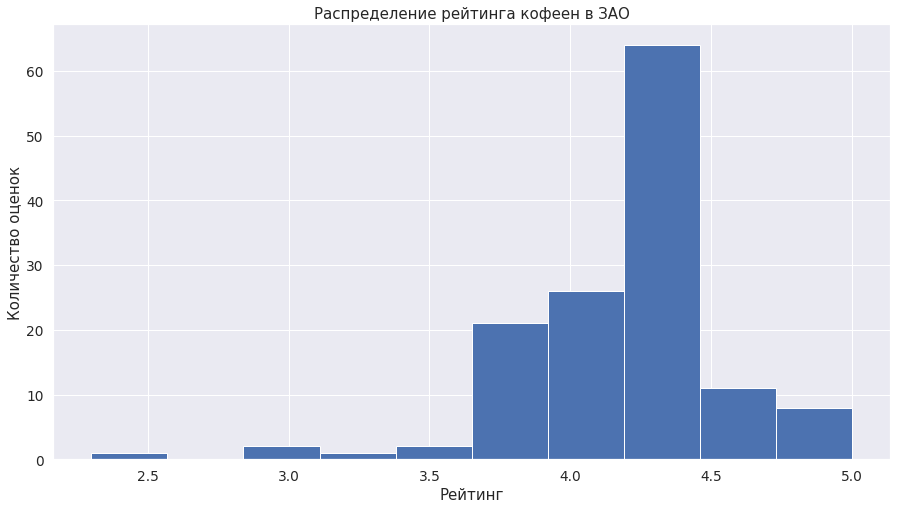

In [59]:
data_coffee_west = data_coffee[data_coffee['district'] == 'Западный административный округ']
data_coffee_west['rating'].hist(figsize=(15, 8))
plt.xlabel('Рейтинг')
plt.ylabel('Количество оценок')
plt.title('Распределение рейтинга кофеен в ЗАО')
plt.show()

Из распределния видно, что рейтинг в ЗАО в среднем отличается от других районов в худшую сторону

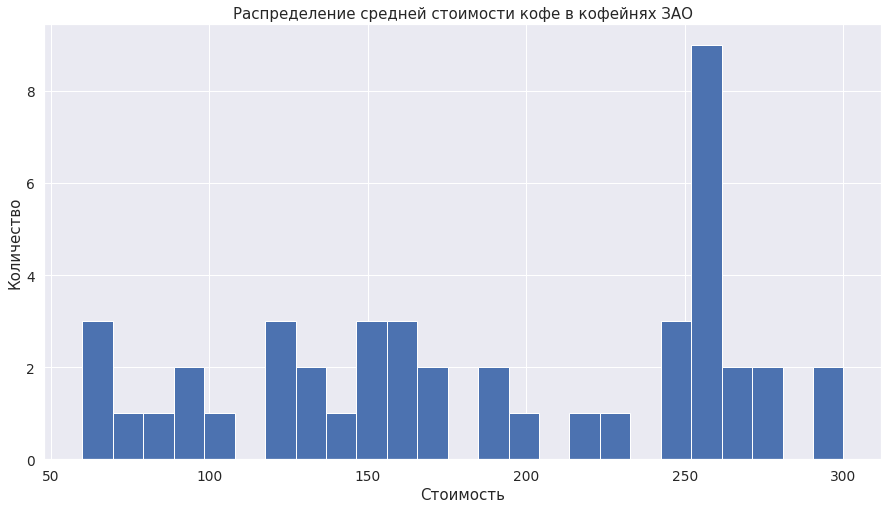

In [60]:
data_coffee_west['middle_coffee_cup'].hist(figsize=(15, 8), bins=25)
plt.xlabel('Стоимость')
plt.ylabel('Количество')
plt.title('Распределение средней стоимости кофе в кофейнях ЗАО')
plt.show()

In [61]:
data_coffee_west['middle_coffee_cup'].value_counts().head()

256.0    6
260.0    3
250.0    3
60.0     3
95.0     2
Name: middle_coffee_cup, dtype: int64

Самое частое значение значение стоиости кофе - 256 рублей. При этом видна фрагментация по сегментам, сегмент от 200 до 240 рублей за чашку кофе представлен слабо

<div class="alert alert-warning">
<b>Комментарий ревьюера: ❗️</b>

Кстати, когда проект уже финально готов, в нем также можно почистить простые выводы таблиц, а также с используемыми методами `head, tail` и тд., чтобы они не загромождали сам проект большим количеством таблиц. Таким образом мы сделаем проект визуально лучше.

</div>

**Взглянем на карту ЗАО, изучим распределение и местоположение заведений общественного питания**

Основные критерии к выбору места:
1. Место должно быть проходное (популярное)
2. Желательно, чтобы по близости было метро
3. Хорошо, если недалеко будет какое-то учебное заведение и место развлечения / досуга
4. По близости не должно быть много конкурентов (кофеен)

In [62]:
m_west_rating = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m_west_rating)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
Choropleth(
    geo_data=state_geo,
    data=data_coffee_west,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений в ЗАО',
).add_to(m_west_rating)
    
data_coffee_west.apply(create_clusters, axis=1)

m_west_rating

Идеальное место на первый взгляд - **Парк имени 50 летия Октября**.  
Большой парк в спальном районе, в 1-1,5 километрах (15-20 мин. пешком) - две станции метро , в самом парке нет кофеен, недалеко от прака находится только одна Шоколадница.Однако в самом парке есть несколько заведений.

**Посмотрим на всех возможных конкурентов чуть более пристально:**

In [63]:
data_competitor = data[(data['name'] == 'Дворик Невского') |
                       (data['name'] == 'Vasyasya') |
                       ((data['name'] == 'Иди обниму')  & (data['address'] == 'Москва, проспект Вернадского, 44, корп. 2')) |
                       ((data['name'] == 'Филин') & (data['district'] == 'Западный административный округ')) |
                       (data['name'] == 'Crop. coffee & smoothie') |
                       (data['name'] == 'Surf Coffee X Akademik') |
                       (data['name'] == 'Park50') |
                       (data['name'] == 'Лавочка') |
                      ((data['name'] == 'Шоколадница') & (data['address'] == 'Москва, улица Удальцова, 40А')) ]
data_competitor

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
5627,Филин,пиццерия,"Москва, Западный административный округ, район...",Западный административный округ,"ежедневно, 09:00–22:00",55.685517,37.499354,4.9,NaN,NaN,NaN,NaN,сетевое заведение,0,район Проспект Вернадского,False
5644,Дворик Невского,кофейня,"Москва, Западный административный округ, район...",Западный административный округ,"ежедневно, 10:00–20:00",55.679118,37.480924,5.0,NaN,NaN,NaN,NaN,несетевое заведение,0,район Проспект Вернадского,False
5745,Шоколадница,кофейня,"Москва, улица Удальцова, 40А",Западный административный округ,"ежедневно, 08:00–23:00",55.683265,37.491988,4.3,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,сетевое заведение,76,улица Удальцова,False
5777,Park50,пиццерия,"Москва, Западный административный округ, район...",Западный административный округ,"ежедневно, 09:00–22:00",55.683021,37.503935,4.9,NaN,NaN,NaN,NaN,несетевое заведение,0,район Проспект Вернадского,False
5803,Лавочка,кафе,"Москва, Западный административный округ, район...",Западный административный округ,NaN,55.681641,37.502490,4.9,NaN,NaN,NaN,NaN,несетевое заведение,0,район Проспект Вернадского,False
5820,Vasyasya,кофейня,"Москва, парк Олимпийской Деревни",Западный административный округ,"ежедневно, 10:00–22:00",55.678322,37.480299,4.0,NaN,NaN,NaN,NaN,несетевое заведение,0,парк Олимпийской Деревни,False
6620,Иди обниму,кофейня,"Москва, проспект Вернадского, 44, корп. 2",Западный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.674816,37.496381,4.4,NaN,NaN,NaN,NaN,сетевое заведение,160,проспект Вернадского,False
6667,Surf Coffee X Akademik,кофейня,"Москва, проспект Вернадского, 41",Западный административный округ,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",55.674674,37.503214,4.8,NaN,NaN,NaN,NaN,несетевое заведение,0,проспект Вернадского,False


Конкурентов можно поделить на 3 типа:
1) кофейня в непосредственной близости (Шоколадница);  
2) кофейни неподалеку (в радиусе 3 км);   
3) общепит непосредственно в парке.  

In [64]:
best_coffee_place_lat, best_coffee_place_lng = 55.682819,37.502024

m_best_place_competitor = Map(location=[best_coffee_place_lat, best_coffee_place_lng], zoom_start=14)
icon_url = 'https://img.icons8.com/cotton/256/coffee-to-go.png'  
icon = CustomIcon(icon_url, icon_size=(50, 50))  
marker = folium.Marker([best_coffee_place_lat, best_coffee_place_lng], icon=icon,)


marker.add_to(m_best_place_competitor)
# создаем карту и маркер выбранного места для кофейне

In [65]:
#Накладываем на карту конкурентов
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

marker_cluster = MarkerCluster().add_to(m_best_place_competitor)    
    
data_competitor.apply(create_clusters, axis=1)

m_best_place_competitor

Ближайшая кофейня и главный конкурент - Шоколадница. Заведение находится недалеко от парка, имеет средний (4.3) рейтинг, средняя стоимость чашки кофе - 256 рублей, что значительно больше среднего по району. Вместимость достаточно большая и работает до 23:00.

По другим близлежащим кофейням информации почти нет (в т.ч. о стоимости кофе).

Помимо кофеен за внимание потенциального посетителя наша кофейня будет конкурировать с другими заведениями общепита. В парки их 3 шт: одно кафе и две пиццерии. Все с хорошим рейтингом (4.9).   


**Исходя из анализа конкурентов и потенциального местоположения кофейни рекомендуется следующая концепция:**  
Имеет смысл открывать небольшую кофейню непосредственно в парке имени 50-летия Октября, без базовой еды (завтраки, ланчи, ужины) - т.к. в парке уже достаточно большая конкуренция в этом сегменте. Кофейня должна быть уютная и небольшая (в противовес Шоколаднице), не более чем на 15-20 посадочных мест, с приятным ремонтом, а также вежливым и внимательным персоналом. Основной упор на качественный кофе, также в продаже должны быть вкусные десерты/выпечка. Так как кофейня маленькая и расположена в парке - особое внимание должно быть уделено на продвижение сегмента Coffee to go, то есть кофе с собой - что может быть приятней прогулки в парке с вкусным кофе?  

Потенциальные клиенты - жители района, гуляющие в парке. Ввиду того, что клиенты в этой локации, как правило, постоянные посетители крайне важно завоевать их лояльность а) качеством кофе б) атмосферой в) ценной.   

<div style="border:solid Gold; padding: 40px">
    
## Итог детализированного исследования для октрытия кофейни <a id="conclusion"></a>  
    
**Оптимальным местом для открытия кофейни является парк имени 50-летия Октября**. В первую очередь этот парк интересен большой проходимостью (расположен в спальном районе), а также отсутствием прямых конкурентов  непосредственно в парке.   
    
**Исходя из приведенного выше анализа рекомендуется принять цену одной чашки капучино (middle_coffee_cup) равной 210-220 рублям**. С одной стороны это выше, чем в среднем по округу, но с другой - в парке нет прямых конкурентов, которые специализируются на кофе, а самый ближайший конкурент имеет цену одной чашки капучино равной 256 рублей, что значительно выше предлагаемой, а ввиду того, что конкурент - это сетевая кофейня, то они не смогут оперативно опустить стоимость кофе в рамках конкурентной борьбы.
    
Основной риск заключается в том, что в соседних пиццериях и кафе делают вкусный и недорогой кофе.  
**Рекомендуется дополнительно исследовать "на земле" эти заведения (провести аудит кофе, если угодно) для принятия финального решения по ценообразованию в кофейне и продаваемой продукции, помимо кофе.**

**Претентацию с выводами и рекомендациями по исследованию можно посмотреть по ссылке:**  
https://docs.google.com/presentation/d/1w2Pe5y-Zp6p27B1cWLsrdwgOl7zH6gIW/edit?usp=sharing&ouid=109686566115576793567&rtpof=true&sd=true

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>

В целом работа очень хорошая. Использовано достаточно большое количество информации, которое складывается в одну общую картинку.
    
На самом деле, там где мы используем повторяющиеся действия по построениям графиков, то есть однотипные графики, рекомендую создавать функции, чтобы не писать один и тот же код несколько раз. Тем самым сможем автоматизировать и оптимизировать свой проект.
    
---
    
    
Презентация сделана хорошо, особенно порадовало:
    
- её структурность
- наличие общих выводов и рекомендаций
- наличие цели
- выводы для всех графиков
- последовательность
- доступность презентации
    
Как её можно было бы ещё улучшить:
    
    
- сформировать summary в самом начале презентации, все любят видеть результат сразу 😊
- пронумеровать слайды
- сделать оглавление
- сделать файл в формате .pdf

    
В остальном всё чудно😊
    

</div>

<div class="alert alert-success">
<b>Комментарий ревьюера: ✅</b>
    

Возвращаю проект обратно, чтобы убедиться что все мои комментарии понятны.
    
Если вдруг у тебя возникнут какие-то вопросы, то я с радостью отвечу на них 😊
    
</div>

<div class="alert alert-info"> Замечания устранены. По ходу работы кое где задал интересующие вопросы. Заранее благодарен за обратную связь по ним. <div> 

<div class="alert alert-success">
<b>Комментарий ревьюера (2): ✅</b>
    
Так, вроде бы ответил на все вопросы 🤝😊

Рад, что в целом все понятно и особенно здорово, что сразу стараешься применить новые знания на практике, ведь так они усвоятся гораздо быстрее. Тогда предлагаю двигаться дальше.
    
Поздравляю с успешным завершением проекта 😊👍
    
И желаю успехов в новых работах 😊
    
    
    
</div>